# Lab-6.1: Time-series visualization

**Author**: J. Hickman

**Instructions** 

[Click here to download the notebook for this lab](lab-6.1.zip)

This notebook consists of TWO parts

(1): **Demonstration section:** The instructors will work through this section during the lab period. It is meant to be educational, with various code examples provided for you. You should understand all code in the demonstration section and should run the cells on your local machine before attempting the assignment.

(2): **Lab assignment:** A short assignment section is also provided after the demonstration. You will have time to work on this during the lab but can finish it at home. 

**NOTE**: It is recommended that you complete this `.ipynb` file in VS-code. Activate the `anly503` environment by selecting the kernel in the upper-left corner of VS-code.  


**Submission:**

* You need to upload ONE documents to Canvas when you are done
  * (1) A PDF (or HTML) of the completed form of this notebook 
* The final uploaded version should NOT have any code-errors present 
* All outputs must be visible in the uploaded version, including code-cell outputs, images, graphs, etc

## Install 

We will be using the following package

`python -m pip install yfinance` 

In [54]:
# Import the yfinance. If you get module not found error the run !pip install yfinance from your Jupyter notebook
import yfinance as yf
import matplotlib.pyplot as plt
import numpy as np 
import plotly.express as px
import statsmodels.api as sm
from IPython.display import IFrame

# Data

## Getting data: Yahoo Finance 

- This package provides a method to get stock data using Python' via the Yahoo API
  - For more see the following [source](https://blog.quantinsti.com/historical-market-data-python-api/)
- Let's retrieval of the `daily` historical price for `AAPL` (Apple)
  - Could also use (PDR S&P 500 ETF Trust (SPY)) or any other stock

In [55]:
start_date='2000-01-01'
end_date='2023-03-01'
stock_ticker="AAPL"; #"SPY"
# Get the data for the stock AAPL
df = yf.download(stock_ticker,start_date,end_date)

# Plot the close price of the AAPL
print("Type =",type(df))
print("N =",len(df))

# there are 252 trading days per year
print("Sanity check:",len(df['Adj Close'])/(252),"years")

df=df.reset_index()

print("head:\n",df.head())
# print("head = ",df['Adj Close'].tail())



[*********************100%***********************]  1 of 1 completed
Type = <class 'pandas.core.frame.DataFrame'>
N = 5826
Sanity check: 23.11904761904762 years
head:
         Date      Open      High       Low     Close  Adj Close     Volume
0 2000-01-03  0.936384  1.004464  0.907924  0.999442   0.850644  535796800
1 2000-01-04  0.966518  0.987723  0.903460  0.915179   0.778926  512377600
2 2000-01-05  0.926339  0.987165  0.919643  0.928571   0.790324  778321600
3 2000-01-06  0.947545  0.955357  0.848214  0.848214   0.721931  767972800
4 2000-01-07  0.861607  0.901786  0.852679  0.888393   0.756128  460734400


## Expected results

* The following is from the Yahoo website, it helps make sense of the downloaded data

![](img/2023-04-16-13-09-02.png)

## Visualization-1

[*********************100%***********************]  2 of 2 completed


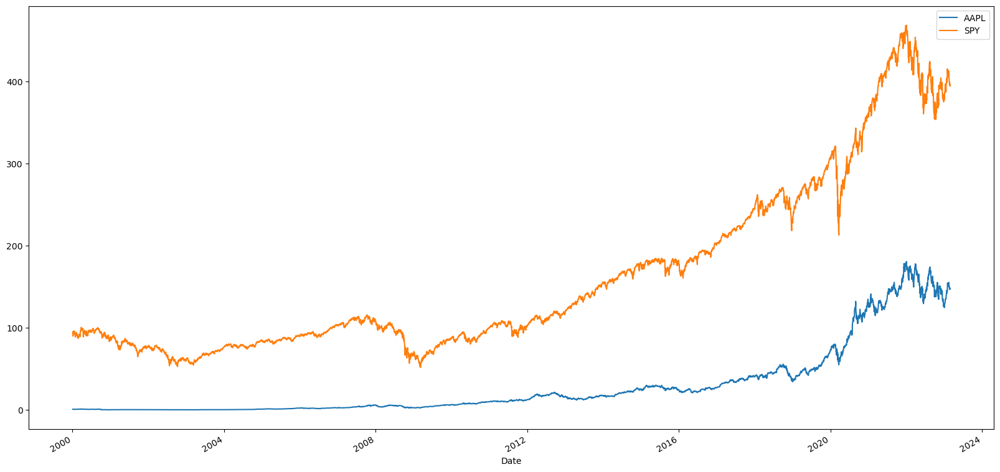

In [56]:
# Get the data for the SPY (an ETF on the S&P 500 index) and the stock Apple by specifying the stock ticker, start date, and end date
df1 = yf.download(['SPY', 'AAPL'],start_date,end_date)
# Plot the adjusted close prices
df1["Adj Close"].plot()
plt.show()

## Minute level data

* Through yfinance, you can also fetch the data of minute frequency. You can download for other frequency by just tweaking the interval parameter on line no 8 below. Following values are supported in the interval: 1m, 5m, 15m,

[*********************100%***********************]  1 of 1 completed


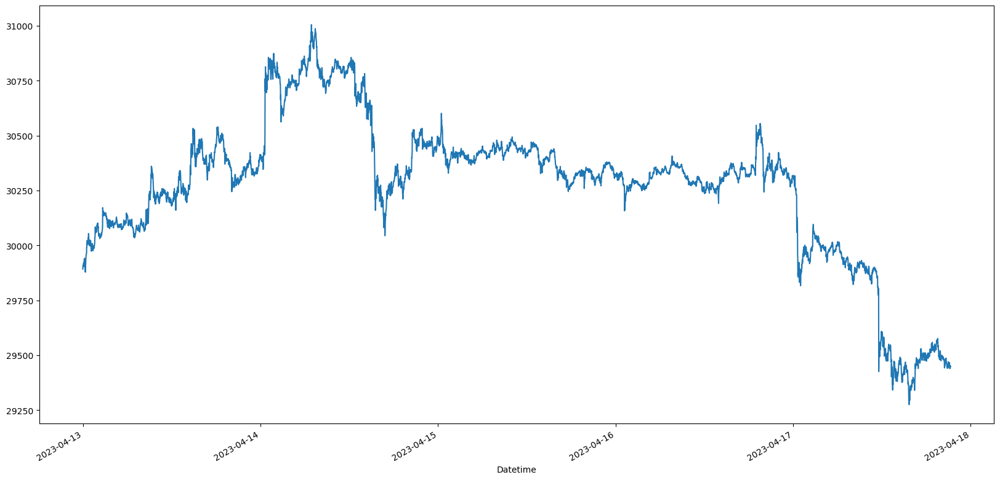

In [57]:
data = yf.download(
		tickers=['BTC-USD'], 
		# use "period" instead of start/end
		# valid periods: 1d,5d,1mo,3mo,6mo,1y,2y,5y,10y,ytd,max
		# (optional, default is '1mo')
		period="5d",
		# fetch data by interval (including intraday if period < 60 days)
		# valid intervals: 1m,2m,5m,15m,30m,60m,90m,1h,1d,5d,1wk,1mo,3mo
       	# (optional, default is '1d')
		interval="1m")
# Plot the close prices
data.Close.plot()
plt.show()

# Basic visualization

## Get data

* Download two time-series for Apple and the S&P 500

In [58]:
# GET DATA AS NUMPY ARRAY 

start_date='2000-01-01'
end_date='2023-03-01'
stock_ticker_1="AAPL";  
stock_ticker_2="SPY"

df1 = yf.download(stock_ticker_1,start_date,end_date)
df1 = df1.reset_index()

df2 = yf.download(stock_ticker_2,start_date,end_date)
df2 = df2.reset_index()

# CONVERT TO NUMPY ARRAYS FOR LATER USE
y1=np.array(df1["Close"])
y2=np.array(df2["Close"])
t=np.array([*range(0,len(y1))]) #market days elapsed since start_date


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


# Plotting utility function-2

Line-plot plotting function for a multiple time-series input in a list

In [59]:
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook_connected"

def plotly_line_plot(t,y,title="Plot",x_label="Open market days since "+start_date+" (days)",y_label="Stock price (USD)"):

    # GENERATE PLOTLY FIGURE
    fig = px.line(x=t,y=y[0], title=title, render_mode='SVG')  
    # IMPORTANT: SVG FIXES RENDER ISSUES WITH SAD FACE 
    # https://community.plotly.com/t/plotly-express-line-charts-are-not-shown/39715
    
    # ADD MORE
    for i in range(1,len(y)):
        fig.add_scatter(x=t,y=y[i], mode='lines')

    fig.update_layout(
        xaxis_title=x_label,
        yaxis_title=y_label,
        template="plotly_white",
        showlegend=False
    )
    fig.show()

# SINGLE SERIES 
plotly_line_plot(t,[y1],title=str(stock_ticker_1)+" stock price")

In [60]:
# MULTIPLE SERIES 
plotly_line_plot(t,[y1,y2],title=str(stock_ticker_1)+" (red) & "+str(stock_ticker_2)+" (blue) stock price")

## Pair plot 

In [61]:
# GET DATA
title="Pairplot: "+str(stock_ticker_1)+" & "+str(stock_ticker_2)+" inter-dependance"
# GENERATE PLOTLY FIGURE
fig = px.scatter(x=y1,y=y2, title=title,height=600,width=800)

fig.update_layout(
    xaxis_title=stock_ticker_1+" Price (USD)",
    yaxis_title=stock_ticker_2+" Price (USD)",
    template="plotly_white",
    showlegend=False
)

fig.show()

#### Assignment: 6.1.1

In the box below, write, in your own words, (1) A meaningful description of the interpretation of the encodings in the last plot (2) A discussion of any note-worthy features arising in the plot (minimum 40 to 50 word). In short, pretend you are writing a caption for the figure in a technical report.  

```
INSERT DESCRIPTION HERE
```

# Seasonal effects

* Seasonal decomposition using moving averages, returns an object with seasonal, trend, and resid attributes.
* For more see: https://www.statsmodels.org/dev/generated/statsmodels.tsa.seasonal.seasonal_decompose.html

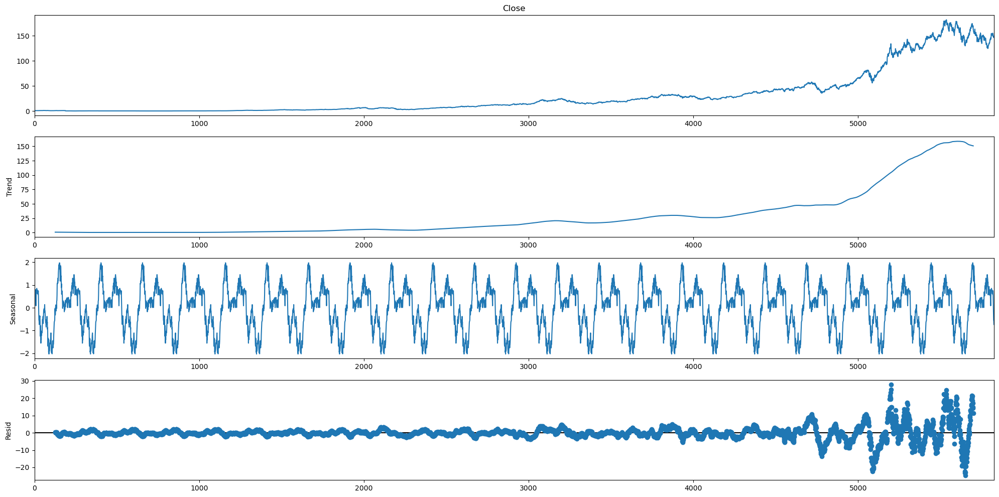

In [62]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [20, 10]

from statsmodels.tsa.seasonal import seasonal_decompose
# there are 252 trading days per year
decompose = seasonal_decompose(df['Close'],model='additive', period=252)
decompose.plot()
plt.show()

# Exponential trend

## Fit exponential trend  

* Visualize long term trend

In [63]:
# CURVE FIT 
from scipy.optimize import curve_fit

def f(t, a, b, c,d):
    return a * np.exp(b * (t-d)) + c

popt1, pcov = curve_fit(f, t, y1,p0=[1000.,0.001,1.0,10])
popt2, pcov = curve_fit(f, t, y2,p0=[1000.,0.001,1.0,10])

print("Fitting parameters-2:",popt1)
print("Fitting parameters-2:",popt2)


Fitting parameters-2: [1.18320108e+02 1.05764953e-03 1.05602009e+00 5.41248324e+03]
Fitting parameters-2: [3.68027890e+01 7.00736935e-04 9.93164433e+01 2.52586387e+03]


In [64]:
plotly_line_plot(t,[y1,f(t,*popt1),y2,f(t,*popt2)],title=str(stock_ticker_1)+" (blue) stock price & exponential fit (green) as compared to SP500 in red")

#### Assignment: 6.1.2

In the box below, write, in your own words, (1) A meaningful description of the interpretation of the encodings in the last plot (2) A discussion of any note-worthy features arising in the plot (minimum 40 to 50 word). In short, pretend you are writing a caption for the figure in a technical report.  

```
INSERT DESCRIPTION HERE
```

## Visualize deviation from exponential trend 

In [65]:
plotly_line_plot(t,[y1-f(t,*popt1),y2-f(t,*popt2)],title=str(stock_ticker_1)+" & "+ str(stock_ticker_2)+" deviation from exponential trend",y_label="Deviation from trend")

#### Assignment: 6.1.3

In the box below, write, in your own words, (1) A meaningful description of the interpretation of the encodings in the last plot (2) A discussion of any note-worthy features arising in the plot (minimum 40 to 50 word). In short, pretend you are writing a caption for the figure in a technical report.  

```
INSERT DESCRIPTION HERE
```

## Deviation pair plot 

In [66]:
# GET DATA
title="Pairplot: "+str(stock_ticker_1)+" & "+str(stock_ticker_2)+" inter-dependance"
# GENERATE PLOTLY FIGURE
fig = px.scatter(x=y1-f(t,*popt1),y=y2-f(t,*popt2), title=title,height=600,width=800)

fig.update_layout(
    xaxis_title=stock_ticker_1+" Price (USD)",
    yaxis_title=stock_ticker_2+" Price (USD)",
    template="plotly_white",
    showlegend=False
)

fig.show()

# Differencing 

## Periodic wrapping

* When computing lag plots and correlation functions, there are two ways to construct the required array. 
  * (1) with periodic wrapping, in this case the array size stays the same (periodic signals)
  * (2) without periodic wrapping, in this case the array size shrinks  (aperiodic signals)
* As we will see, the chosen method effects the observed results
* The following shows simple examples of the two possible cases 


In [67]:
# WITH WRAPPING 

tmp=np.array([0,1,2,3])
print(np.roll(tmp,0))
print(np.roll(tmp,1))
print(np.roll(tmp,2))
print(np.roll(tmp,3))
print(np.roll(tmp,4))

[0 1 2 3]
[3 0 1 2]
[2 3 0 1]
[1 2 3 0]
[0 1 2 3]


In [68]:
# WITHOUT WRAPPING 

# original y0,y1,y2,y3,4
# lag1
    # ytm1: y0,y1,y2,y3
    # yt:   y1,y2,y3,y4
# lag2 
    # ytm2: y0,y1,y2 
    # yt:   y2,y3,y4 
    
# TEST
print(tmp[0:])
print(tmp[0:])
print(tmp[0:-1])
print(tmp[1:])
print(tmp[0:-2])
print(tmp[2:])  


[0 1 2 3]
[0 1 2 3]
[0 1 2]
[1 2 3]
[0 1]
[2 3]


## Differencing (lag-1 day)

* Apply differencing method with lag=1 and re-visualize
* Notice how only very rapid (daily) oscillations remain (everything that is constant over 1 day is removed)

In [69]:
# MODIFIY DATA
LD=1 #lag_for_differencing
print(len(y1),len(y1[0:-LD]),len(y1[LD:]))

# GENERATE PLOTLY FIGURE
title=str(stock_ticker_1)+" after applying differencing using a lag of "+str(LD)+ " day"
plotly_line_plot([*range(0,len(y1[0:-LD]))],[y1[0:-LD]-y1[LD:]],title=title,y_label="differencing with lag="+str(LD))



5826 5825 5825


# Lag plots

## Lag-plots 

* A lag plot checks whether a data set or time series is random or not. 
* Random data should not exhibit any identifiable structure in the lag plot. 
* Non-random structure in the lag plot indicates that the underlying data are not random. 


In [70]:
# UTILITY FUNCTION

import warnings
warnings.filterwarnings("ignore")

def lag_plots(y1,y2,d_lag=1,NLag=5):
    plots_per_row=3
    num_rows=int(np.ceil((NLag+1)/plots_per_row))  
    #print(plots_per_row,num_rows)

    fig, axs = plt.subplots(num_rows,plots_per_row,figsize=(12, 3.25*num_rows))
    fig.suptitle('Lag plots')

    # # UN-LAGGED 
    axs[0,0].plot(y2, y1,"o")
    axs[0,0].set_xlabel("y2_t");  axs[0,0].set_ylabel("y1_t");

    row=0; lag=d_lag
    while row<num_rows:
        col=0
        if(row==0): col=1
        while col<plots_per_row:
            #print(row,col)
            tmp1=y1[0:-lag] #stationary
            tmp2=y2[lag:]
            axs[row,col].plot(tmp2, tmp1,"o")
            label="y2 lag="+str(lag)
            # axs[row,col].set_ylabel("y1_t");  
            axs[row,col].set_xlabel(label);
            lag+=d_lag
            col+=1
            if(lag/d_lag>NLag): break
        if(lag/d_lag>NLag): break
        row+=1
        
    fig.show()

## Lag plots: Apple-Apple (no differencing)

* There is very long term correlation due to the exponential trend

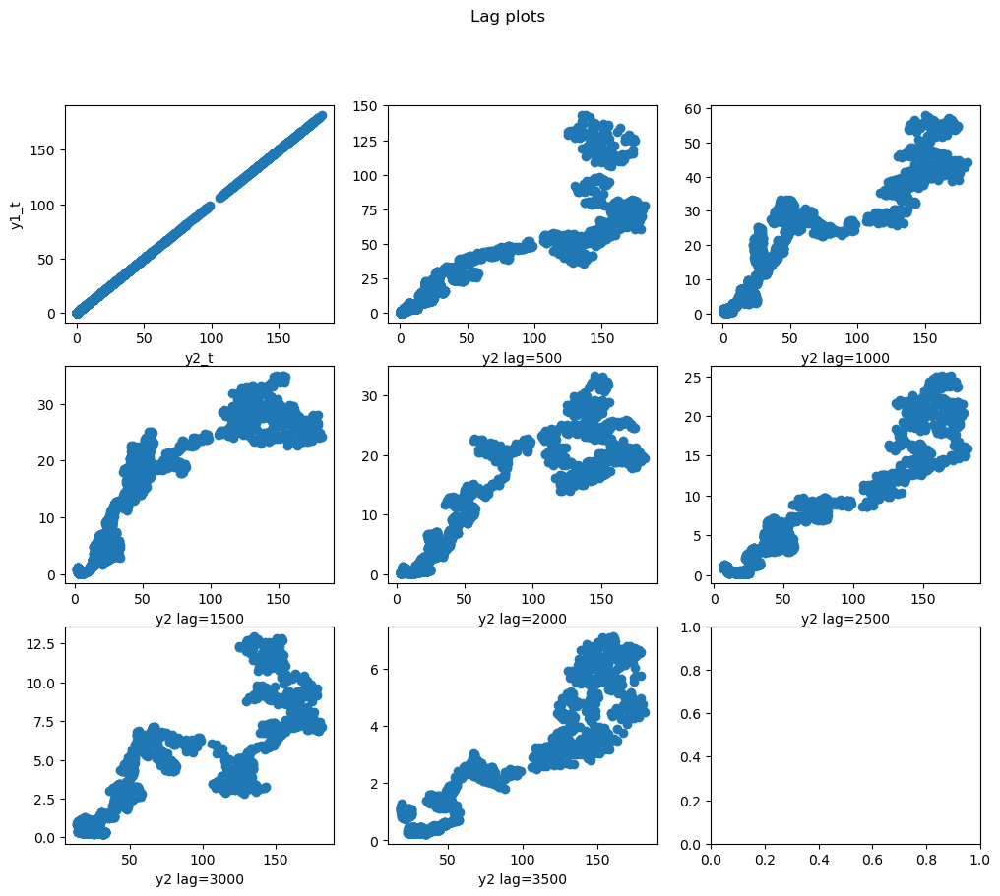

In [71]:
lag_plots(y1,y1,d_lag=500,NLag=7)

#### Assignment: 6.1.4

In the box below, write, in your own words, (1) A meaningful description of the interpretation of the encodings in the last plot (2) A discussion of any note-worthy features arising in the plot (minimum 40 to 50 word). In short, pretend you are writing a caption for the figure in a technical report.  

```
INSERT DESCRIPTION HERE
```

## Apply Differencing (lag=10): Line plot

In [72]:
# GET DATA
LD=10 #lag_for_differencing

# GENERATE PLOTLY FIGURE
title=str(stock_ticker_1)+" after applying differencing using a lag of "+str(LD)+ " day"
plotly_line_plot([*range(0,len(y1[0:-LD]))],[y1[0:-LD]-y1[LD:]],title=title,y_label="differencing with lag="+str(LD))


## Apply Differencing (lag=10): Lag plots

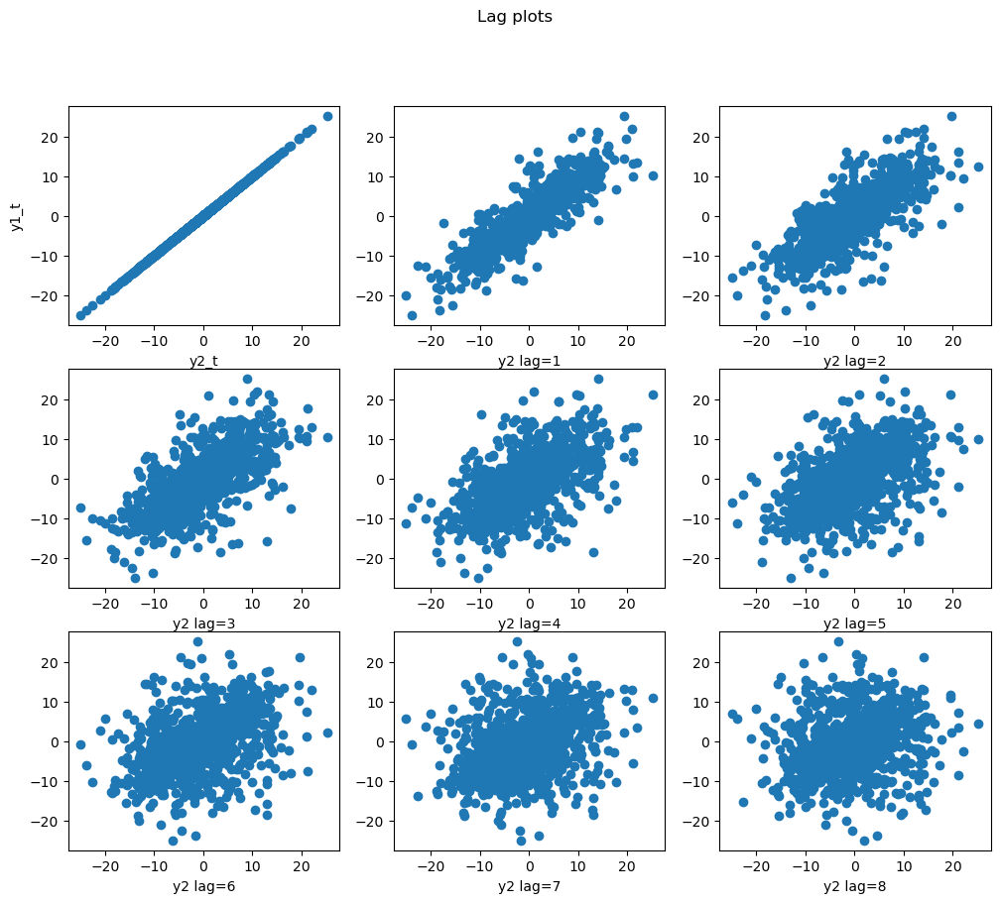

In [73]:
lag_plots(y1[0:-LD]-y1[LD:],y1[0:-LD]-y1[LD:],d_lag=1,NLag=8)

#### Assignment: 6.1.5

In the box below, write, in your own words, (1) A meaningful description of the interpretation of the encodings in the last plot (2) A discussion of any note-worthy features arising in the plot (minimum 40 to 50 word). In short, pretend you are writing a caption for the figure in a technical report.  

```
INSERT DESCRIPTION HERE
```

# Correlation function

## Auto-correlation 

* There are MANY ways to compute the "auto-correlation" and "cross-correlation" functions 
* Because of the different methods, the exact meaning of the various outputs can be some-what confusing to interpret
* See the "Appendix" section for more details on correlation functions 
* **Important**: When both signals are the same, the cross-correlation function (CCF) becomes the auto-correlation function (ACF)

In [74]:
def CCF(y1,y2,title="Correlation function"):
    CCF=sm.tsa.stattools.ccf(y1, y2, adjusted=False,fft=False)
    plotly_line_plot([*range(0,len(CCF))],[CCF],title=title,x_label="Lag time (days)",y_label="Correlation function")
    
CCF(y1,y1,title="Auto-correlation function: (APPL-APPL)")
CCF(y2,y2,title="Auto-correlation function: (S&P-S&P)")
CCF(y1,y2,title="Cross-correlation function between (APPL-S&P)")

#### Assignment: 6.1.6

In the box below, write, in your own words, (1) A meaningful description of the interpretation of the encodings in the last plot (2) A discussion of any note-worthy features arising in the plot (minimum 40 to 50 word). In short, pretend you are writing a caption for the figure in a technical report.  

```
INSERT DESCRIPTION HERE
```

## Power spectrum 

## Code

In [75]:
from  scipy.fft import fft,fftfreq,ifft

def power_spectrum_plot(s,dt=1,normalize=True,upr=1.0):

    # s=s-np.mean(s)
    N=len(s);  			#NUMBER OF POINTS 
    fn=fftfreq(N)/(dt)	#SET OF FREQ FOR PLOTTING (Hz)

    # FOURIER TRANSFORM 
    FT=fft(s)

    # EXTRACT SIN AND COS AMPLITUDES
    # (FACTOR OF 2 IS FOR CONVERSION FROM REAL TO COMPLEX)
    # sum(an*cos(wt)+bn*sin(wt))
    an=2*np.real(FT)/N
    bn=-2*np.imag(FT)/N
    
    #SPECTRAL POWER DENSITY 
    #(FACTOR OF 4 IS FOR CONVERSION FROM REAL TO COMPLEX)
    # N SQUARE IS FOR SCIPY NORMALIZATION CONVENTION 
    SPD=np.absolute(FT)**2.0
    SPD=4*SPD/N/N
    # plt.plot(fn,4*SPD/N/N,'-o'); plt.show()
    

    # PLOT SIN/COS AMPLITUDES 
    # plt.plot(fn,an, '-o'); plt.show()
    # plt.plot(fn,bn, '-o'); plt.show()

    # POSITIVE PART ONLY
    # https://docs.scipy.org/doc/scipy/reference/generated/scipy.fft.fftfreq.html#scipy.fft.fftfreq
    # f = [0, 1, ...,   n/2-1,     -n/2, ..., -1] / (d*n)   if n is even
    # f = [0, 1, ..., (n-1)/2, -(n-1)/2, ..., -1] / (d*n)   if n is odd
     # index of minimum frequency to keep
    upr=int(len(fn)*upr)

    plotly_line_plot(fn[:upr],[an[:upr]],title="",x_label="Oscillation frequency (f)",y_label="Cosine Amplitudes")
    plotly_line_plot(fn[:upr],[bn[:upr]],title="",x_label="Oscillation frequency (f)",y_label="Sine Amplitudes")


    tmp=SPD
    if normalize:
        tmp=SPD/np.max(SPD)

    # tmp=4*SPD/N/N
    plotly_line_plot(fn[:upr],[tmp[:upr]],title="Power-spectrum",x_label="Oscillation frequency (f)",y_label="Power spectrum")
    
    # 252 trading days per year 
    plotly_line_plot((1./fn[:upr]),[tmp[:upr]],title="Power-spectrum",x_label="Oscillation period (T=1/f))",y_label="Power spectrum")


power_spectrum_plot(y1)


# Study effect of differencing  

## Differencing (lag=1)

In [76]:

# GET DATA
LD=1 #lag_for_differencing

plotly_line_plot([*range(0,len(y1[0:-LD]))],[y1[0:-LD]-y1[LD:]],title=title,y_label="differencing with lag="+str(LD))

CCF(y1[0:-LD]-y1[LD:],y1[0:-LD]-y1[LD:],title="Auto-correlation function: Differenced (APPL-APPL)")

# GENERATE PLOTLY FIGURE
title=str(stock_ticker_1)+" after applying differencing using a lag of "+str(LD)+ " day"

power_spectrum_plot(y1[0:-LD]-y1[LD:])

## Differencing (lag=10 days)

In [77]:

# GET DATA
LD=10 #lag_for_differencing

plotly_line_plot([*range(0,len(y1[0:-LD]))],[y1[0:-LD]-y1[LD:]],title=title,y_label="differencing with lag="+str(LD))

CCF(y1[0:-LD]-y1[LD:],y1[0:-LD]-y1[LD:],title="Auto-correlation function: Differenced (APPL-APPL)")

# GENERATE PLOTLY FIGURE
title=str(stock_ticker_1)+" after applying differencing using a lag of "+str(LD)+ " day"

power_spectrum_plot(y1[0:-LD]-y1[LD:])

#### Assignment: 6.1.7 (last question)

In the box below, write, in your own words, (1) A meaningful description of the interpretation of the encodings in the ACF plot and Power spectrum plotted as a function of frequency (2) A discussion of any note-worthy features arising in the plot (minimum 40 to 50 word). In short, pretend you are writing a caption for the figure in a technical report.  

```
INSERT DESCRIPTION HERE
```

## Differencing (lag=100 days)

In [78]:

# GET DATA
LD=100 #lag_for_differencing

plotly_line_plot([*range(0,len(y1[0:-LD]))],[y1[0:-LD]-y1[LD:]],title=title,y_label="differencing with lag="+str(LD))

CCF(y1[0:-LD]-y1[LD:],y1[0:-LD]-y1[LD:],title="Auto-correlation function: Differenced (APPL-APPL)")

# GENERATE PLOTLY FIGURE
title=str(stock_ticker_1)+" after applying differencing using a lag of "+str(LD)+ " day"

power_spectrum_plot(y1[0:-LD]-y1[LD:])

# Appendix 

Sanity checks

## Toy Data: 

* Time-series with known solution 
  * $f(t)=cos(t)$

In [79]:

t=np.linspace(0,2*np.pi,1000)
y3=np.cos(t)
ACF_gt=0.5*np.cos(t) # ground truth ACF
ACF_gt_norm=ACF_gt/ACF_gt[0] # ground truth ACF (normalized)


## Numpy correlate

* There are MANY ways to compute the "auto-correlation" and "cross-correlation" functions 
* Because of the different methods, the exact meaning of the various outputs can be some-what confusing to interpret
* Below we will sort through the various methods
* Many methods use: numpy. correlate $(a, v$, mode= 'valid' $)$ to compute Cross-correlation of two 1-dimensional sequences.
* This function computes the correlation as generally defined in signal processing texts:
$$
c_k=\sum_n a_{n+k} \cdot \bar{v}_n
$$

* Notice how the means of the time-series are NOT subtracted out before computing the cross-correlation (this must be done manually)
* Further more, it is computing the sum of the product NOT the mean.

In [80]:
# SIMPLE SANITY CHECKS 
print(np.correlate([1, 2, 3], [0, 1, 0.5]))
print(np.sum(np.array([1, 2, 3])*np.array([0, 1, 0.5])))

print(np.correlate([1, 2, 3], [0, 1, 0.5], "full"))
print(np.sum(np.array([1])*np.array([0.5]))) # -2 
print(np.sum(np.array([1, 2])*np.array([1, 0.5]))) # -1 
print(np.sum(np.array([1, 2, 3])*np.array([0, 1, 0.5]))) # 0
print(np.sum(np.array([2, 3])*np.array([0, 1]))) # + 1 
print(np.sum(np.array([3])*np.array([0]))) # + 2

print(np.correlate([1, 2, 3.1], [4, 5, 6.1], "same"))
print(np.sum(np.array([1, 2])*np.array([5, 6.1]))) # -1 
print(np.sum(np.array([1, 2, 3.1])*np.array([4, 5., 6.1]))) # 0
print(np.sum(np.array([2, 3.1])*np.array([4, 5.]))) # + 1 

[3.5]
3.5
[0.5 2.  3.5 3.  0. ]
0.5
2.0
3.5
3
0
[17.2  32.91 23.5 ]
17.2
32.91
23.5


## Matplotlib method

* The auto-correlation using Matplotlib is performed with numpy.correlate() with mode = "full".

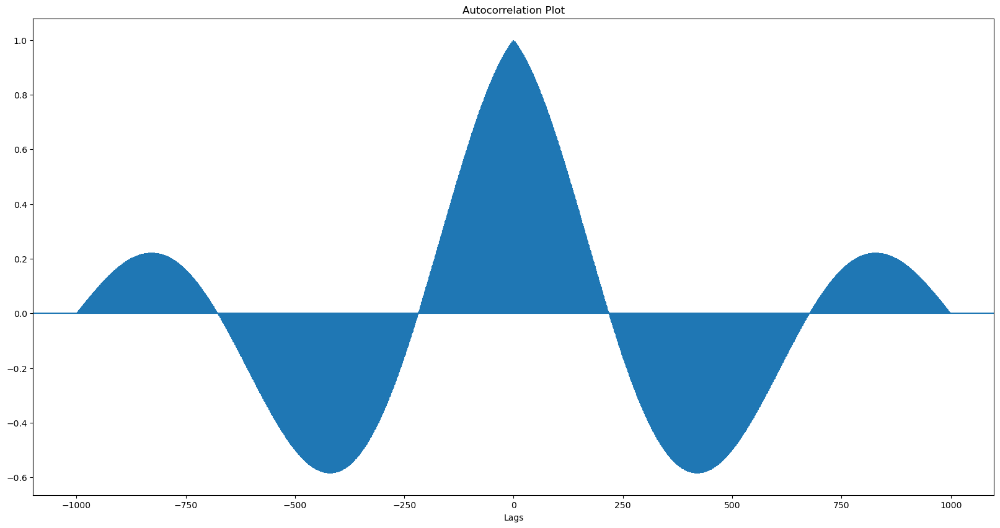

In [81]:
# Adding plot title.
plt.title("Autocorrelation Plot")
 
# Providing x-axis name.
plt.xlabel("Lags")
 
# Plotting the Autocorrelation plot.
ACF_MPL=plt.acorr(y3, maxlags = len(y3)-1, normed=True, usevlines=True)
plt.show()

#EXTRACT THE POSITIVE SHIFTS
half=int(len(ACF_MPL[0])/2);
lags=ACF_MPL[0][half:]
ACF_MPL=ACF_MPL[1][half:] 

## Cross-correlation with Numpy-correlate

* Remember, when both signals are the same, the cross-correlation function (CCF) becomes the auto-correlation function (ACF)

In [82]:
def cross_correlation_np(y1,y2,subtract_means=True,normalize=True): 
    N=len(y1)
    if subtract_means:
        y1=y1-np.mean(y1)
        y2=y2-np.mean(y2)
    lags=np.array([*range(0,N)]);  #lags=lags[N:]
    CCF=np.correlate(y1, y2, mode='full')  # SUM
    CCF=CCF[N-1:]	# EXTRACT POSITIVE HALF
    # DON'T NEED TO WORRY ABOUT 1/N^2 SINCE IT CANCELS 
    if normalize:
        CCF=CCF/np.correlate(y1, y2)
    return [lags,CCF]

[tmp,ACF_NP]=cross_correlation_np(y3,y3,subtract_means=False)

print(len(lags),len(ACF_MPL),len(ACF_NP))
plotly_line_plot(lags,[ACF_MPL,ACF_NP+0.01],title="ACF-1 (APPLE)",x_label="lag tau(days)",y_label="ACF")

1000 1000 1000


## Direct calculation method

* Repeat the calculation but a bit more explicitly

In [83]:
# DIRECT CALCULATION UTILITY FUNCTION 
def cross_correlation_direct(y1,y2, wrap=False, normalize=True, adjusted=True): 
    # print(y1.shape,y2.shape)
    
    # ERRORS
    if(len(y1)!=len(y2)):
        print("ERROR: y1 and y2 must have the same length"); return
        
    # CONVERT 
    y1=np.array(y1)
    y2=np.array(y2)
    # print(y1.shape,y2.shape)

    # COMPUTE 
    u1=np.mean(y1); s1=np.std(y1)
    u2=np.mean(y2); s2=np.std(y2)

    # INITIALIZE
    lags=[*range(0,len(y1))]
    CCF=[]
    CCF.append(np.mean((y1-u1)*(y2-u2)))
    
    for l in lags[1:]:
        # USE PERIODIC WRAPPING
        if wrap:
            CCF.append(np.mean((y1-u1)*(np.roll(y2,-l)-u2)))     
            
        # DONT' USE PERIODIC WRAPPING
        else: 
            # print(y1[0:-l].shape,y2[l:].shape)
            # if(l==len(lags)): break
            if adjusted:
                CCF.append( np.sum((y1[0:-l]-u1)*(y2[l:]-u2))/len(y1[0:-l])) 
            else: 
                CCF.append( np.sum((y1[0:-l]-u1)*(y2[l:]-u2))/len(y1)) 
    CCF=np.array(CCF)

    if normalize:
        CCF=CCF/CCF[0]    
        
    return [lags,CCF]

# STAT MODELS METHOD (WITH ADJUSTMENT)
ACF_SM=sm.tsa.stattools.ccf(y3, y3, adjusted=True,fft=False)
[lags,ACF_D]=cross_correlation_direct(y3,y3,wrap=False, normalize=True, adjusted=True)

print(len(lags),len(ACF_SM),len(ACF_D))
plotly_line_plot(lags,[ACF_SM,ACF_D-0.01],title="ACF: APPLE",x_label="lag tau(days)",y_label="ACF")

1000 1000 1000


## Repeat but remove the means and no adjustment 

* Subtract out the means this time and compare with the `statsmodels` computation

$$\rho_{X X}\left(t_1, t_2\right)=\frac{\mathrm{K}_{X X}\left(t_1, t_2\right)}{\sigma_{t_1} \sigma_{t_2}}=\frac{\mathrm{E}\left[\left(X_{t_1}-\mu_{t_1}\right) \overline{\left(X_{t_2}-\mu_{t_2}\right)}\right]}{\sigma_{t_1} \sigma_{t_2}}$$

In [84]:

# GET DATA
# LD=10 #lag_for_differencing
# y_D=y1[0:-LD]-y1[LD:]


# STAT MODELS METHOD
ACF_SM1=sm.tsa.stattools.ccf(y3, y3, adjusted=False,fft=False)

# STAT MODELS METHOD (FFT)
ACF_SM2=sm.tsa.stattools.ccf(y3, y3, adjusted=False,fft=True)

[lags,ACF_D]=cross_correlation_direct(y3,y3,wrap=False, normalize=True, adjusted=False)
[lags,ACF_NP]=cross_correlation_np(y3,y3,subtract_means=True)

print(len(lags),len(ACF_SM1),len(ACF_NP),len(ACF_D))
plotly_line_plot(lags,[ACF_SM1,ACF_SM1+0.01,ACF_NP+0.005,ACF_D-0.005],title="ACF: APPLE",x_label="lag tau(days)",y_label="ACF")

1000 1000 1000 1000


## ACF from Fourier transform 

* ACF from Wiener–Khinchin theore
* https://en.wikipedia.org/wiki/Autocorrelation#Auto-correlation_of_stochastic_processes


In [85]:
from  scipy.fft import fft,fftfreq,ifft
def ACF_WK(y,normalize=True):
    y=y-np.mean(y)
    N=len(y);  			#NUMBER OF POINTS 
    acf=np.real(ifft(np.conjugate(fft(y))*fft(y)))/N
    if normalize:
        acf=acf/acf[0]
    return acf
# plt.plot(tau,acf_direct/N, '-');		#expected solution

In [86]:
# DIRECT METHOD
[lags,ACF_D]=cross_correlation_direct(y3,y3,wrap=True, normalize=True, adjusted=False)

# WEINER-KHINCHIN METHOD
ACF1=ACF_WK(y3) 

# PLOT
print(len(lags),len(ACF_SM),len(ACF_D))
plotly_line_plot(lags,[ACF1,ACF_D-0.01,ACF_gt_norm+0.01],title="ACF (normalized): cos(t)",x_label="lag tau(days)",y_label="ACF")


1000 1000 1000


In [87]:
# DIRECT METHOD
[lags,ACF_D]=cross_correlation_direct(y3,y3,wrap=True, normalize=False, adjusted=False)

# WEINER-KHINCHIN METHOD
ACF1=ACF_WK(y3, normalize=False) 

# PLOT
print(len(lags),len(ACF_SM),len(ACF_D))
plotly_line_plot(lags,[ACF1-0.01,ACF_D,ACF_gt+0.005],title="ACF (un-normalized): cos(t)",x_label="lag tau(days)",y_label="ACF")


1000 1000 1000


In [88]:
# STAT MODELS METHOD
ACF_SM1=sm.tsa.stattools.ccf(y3, y3, adjusted=False,fft=False)

# STAT MODELS METHOD (FFT)
ACF_SM2=sm.tsa.stattools.ccf(y3, y3, adjusted=False,fft=True)

[lags,ACF_D]=cross_correlation_direct(y3, y3,wrap=False, normalize=True, adjusted=False)
[lags,ACF_NP]=cross_correlation_np(y3, y3,subtract_means=True)

print(len(lags),len(ACF_SM1),len(ACF_NP),len(ACF_D))
plotly_line_plot(lags,[ACF_gt_norm,ACF_SM1,ACF_SM1+0.01,ACF_NP+0.005,ACF_D-0.005],title="ACF: APPLE",x_label="lag tau(days)",y_label="ACF")

1000 1000 1000 1000


## Power spectra

In [89]:
# print("f =",1.0/(2*np.pi))
pi=np.pi
t=np.linspace(0,2,5000)
y3=2.3*np.cos(2*pi*1*t)+np.sin(2*pi*4.5*t)
plotly_line_plot(t,[y3])
power_spectrum_plot(y3,dt=t[1]-t[0],normalize=False,upr=0.05)

## Power spectrum: Exponential 

![](img/2023-04-17-07-16-45.png)

In [90]:
# print("f =",1.0/(2*np.pi))
pi=np.pi
t=np.linspace(0,2,5000)
k0=2
y3=np.exp(k0*t) 
plotly_line_plot(t,[y3])
power_spectrum_plot(y3,dt=t[1]-t[0],normalize=False,upr=0.05)